# Group Assignment 4
*By M. Nolan Gray*

Where do we observe vehicular homelessness at statistically significant rates? To understand this question, I will conduct a spatial autocorrelation analysis and play with some of the methods covered in Week 7 along the way.

As I discuss below, the final product this week has certain issues. I suspect that has to do with a handful of extreme outliers. My plan for Thanksgiving week is to continue refining it, removing outliers where appropriate and exploring how this affects the output.

## Prepping the Data

As always, we start by importing libraries.

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import matplotlib.pyplot as plt
import plotly.express as px

'hdctla' is a geojson file containing vehicular homeless rates by census tract. I made it in a previous notebook. 'population' is a csv file containing the total population for each censust tract in LA—I need this to normalize the vehicular homelessness rates by population.

In [2]:
hdctla = gpd.read_file('output/hdctla.json')
population = gpd.read_file('Data/acs2019_5yr_B01003_14000US06037103400.csv')

In the next few code boxes, I'll be probing the files to see what I'm working with it.

In [3]:
hdctla.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1004 entries, 0 to 1003
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   tract     1004 non-null   object  
 1   LA        1004 non-null   object  
 2   cars      1004 non-null   float64 
 3   vans      1004 non-null   float64 
 4   campers   1004 non-null   float64 
 5   total     1004 non-null   float64 
 6   geometry  1004 non-null   geometry
dtypes: float64(4), geometry(1), object(2)
memory usage: 55.0+ KB


In [4]:
hdctla.head(5)

,tract,LA,cars,vans,campers,total,geometry
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-118.29792 34.26322, -118.2969..."
1,101122,1,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-118.27742 34.25990, -118.2774..."
2,101210,1,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-118.28592 34.25589, -118.2859..."
3,101220,1,0.000,0.000,15.912,15.912,"MULTIPOLYGON (((-118.27817 34.25577, -118.2782..."
4,101300,1,0.000,0.000,1.989,1.989,"MULTIPOLYGON (((-118.26526 34.25238, -118.2653..."


<AxesSubplot:>

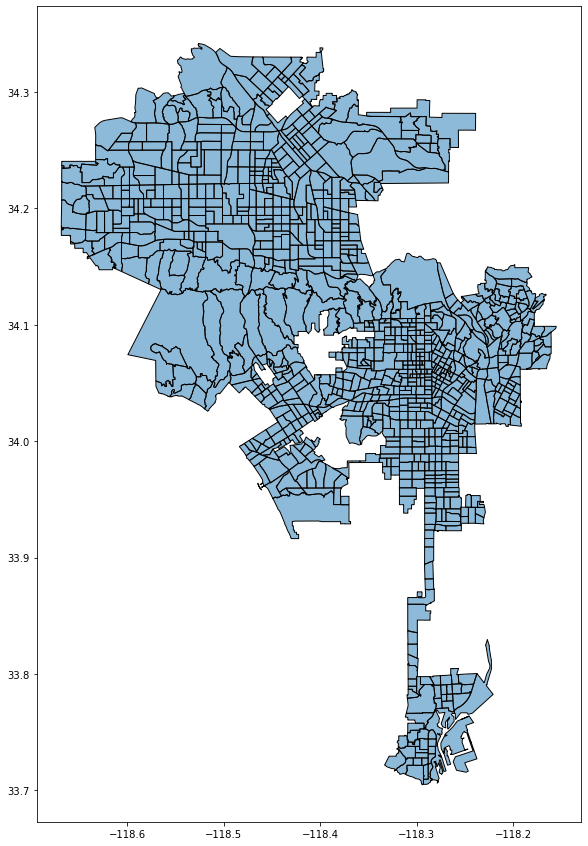

In [5]:
fig,ax = plt.subplots(figsize=(15,15))
hdctla.plot(ax=ax,zorder=10,alpha=0.5)
hdctla.boundary.plot(ax=ax,color='white',zorder=15,lw=0.5)
hdctla.boundary.plot(ax=ax,color='black',zorder=20,lw=1)

In [6]:
population.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1005 entries, 0 to 1004
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   geoid             1005 non-null   object  
 1   name              1005 non-null   object  
 2   B01003001         1005 non-null   object  
 3   B01003001, Error  1005 non-null   object  
 4   geometry          0 non-null      geometry
dtypes: geometry(1), object(4)
memory usage: 39.4+ KB


In [7]:
population.tail(5)

,geoid,name,B01003001,"B01003001, Error",geometry
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",26,18,None
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0,12,None
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175,178,None
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0,12,None
1004,16000US0644000,"Los Angeles, CA",3966936,82,None


Let's clean up the 'population' data.

In [8]:
population = population[['geoid','B01003001']]
population.columns = ['tract','TotalPop']
population = population.drop(1004)

In [9]:
population.head(5)

,tract,TotalPop
0,14000US06037101110,4283
1,14000US06037101122,3405
2,14000US06037101210,6347
3,14000US06037101220,3702
4,14000US06037101300,3884


In [10]:
population['tract'] = population['tract'].str[12:]

In [11]:
population.head(5)

,tract,TotalPop
0,101110,4283
1,101122,3405
2,101210,6347
3,101220,3702
4,101300,3884


And now, let's merge them by tract ID.

In [12]:
merge = hdctla.merge(population,on='tract')

In [13]:
merge.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1001 entries, 0 to 1000
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   tract     1001 non-null   object  
 1   LA        1001 non-null   object  
 2   cars      1001 non-null   float64 
 3   vans      1001 non-null   float64 
 4   campers   1001 non-null   float64 
 5   total     1001 non-null   float64 
 6   geometry  1001 non-null   geometry
 7   TotalPop  1001 non-null   object  
dtypes: float64(4), geometry(1), object(3)
memory usage: 70.4+ KB


Hmm, only 1001 records matched out of 1004. Something I'll need to look into next week. Anyway, let's check it out.

In [14]:
merge.head(5)

,tract,LA,cars,vans,campers,total,geometry,TotalPop
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-118.29792 34.26322, -118.2969...",4283
1,101122,1,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-118.27742 34.25990, -118.2774...",3405
2,101210,1,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-118.28592 34.25589, -118.2859...",6347
3,101220,1,0.000,0.000,15.912,15.912,"MULTIPOLYGON (((-118.27817 34.25577, -118.2782...",3702
4,101300,1,0.000,0.000,1.989,1.989,"MULTIPOLYGON (((-118.26526 34.25238, -118.2653...",3884


## Normalizing Vehicular Homelessness by Population

Okay, let's normalize rates of vehicular homelessness, not unlike what we did in class for crime.

In [15]:
merge['TotalPop'] = merge['TotalPop'].astype(float)

In [16]:
merge['total_per_1000'] = merge['total']/merge['TotalPop']*1000
merge['cars_per_1000'] = merge['cars']/merge['TotalPop']*1000
merge['vans_per_1000'] = merge['vans']/merge['TotalPop']*1000
merge['campers_per_1000'] = merge['campers']/merge['TotalPop']*1000

Let's check it out.

In [17]:
merge.head(5)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-118.29792 34.26322, -118.2969...",4283.0,0.000000,0.000000,0.000000,0.000000
1,101122,1,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-118.27742 34.25990, -118.2774...",3405.0,1.560059,0.471953,1.088106,0.000000
2,101210,1,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-118.28592 34.25589, -118.2859...",6347.0,2.047424,0.253190,1.167481,0.626753
3,101220,1,0.000,0.000,15.912,15.912,"MULTIPOLYGON (((-118.27817 34.25577, -118.2782...",3702.0,4.298217,0.000000,0.000000,4.298217
4,101300,1,0.000,0.000,1.989,1.989,"MULTIPOLYGON (((-118.26526 34.25238, -118.2653...",3884.0,0.512101,0.000000,0.000000,0.512101


Let's identify the top 20 tracts for normalized vehicular homelessness.

In [18]:
merge = merge.to_crs(epsg=3857)

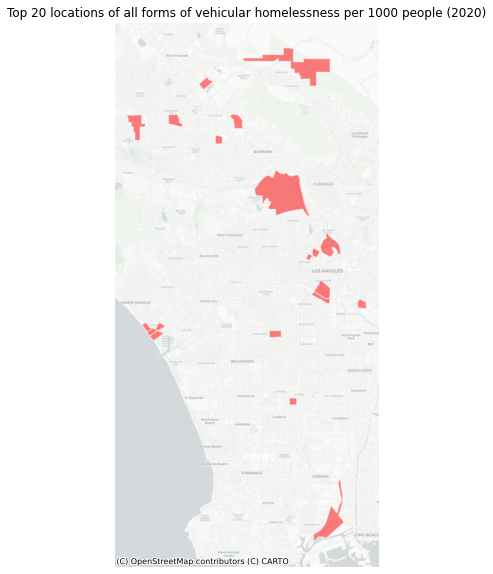

In [19]:
fig,ax = plt.subplots(figsize=(12,10))
merge.sort_values(by='total_per_1000',ascending=False)[:20].plot(ax=ax,
                                                                 color='red',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)

ax.set_title('Top 20 locations of all forms of vehicular homelessness per 1000 people (2020)')
ax.axis('off')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Right, so kind of what we already knew: industrial NoHo and San Pedro, Venice, the neighborhoods around Downtown. Let's make some chloropleth maps for each type of vehicular homelessness.

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)


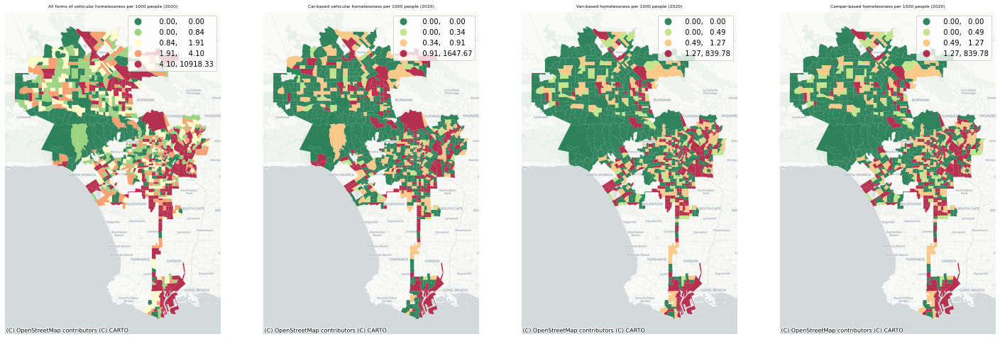

In [20]:
fig,axs = plt.subplots(1,4,figsize=(25,25))
ax1, ax2, ax3, ax4 = axs

merge.plot(ax=ax1,
        column='total_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax1.axis('off')
ax1.set_title('All forms of vehicular homelessness per 1000 people (2020)',fontsize=6)
ctx.add_basemap(ax1,source=ctx.providers.CartoDB.Positron)

merge.plot(ax=ax2,
        column='cars_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax2.axis('off')
ax2.set_title('Car-based vehicular homelessness per 1000 people (2020)',fontsize=6)
ctx.add_basemap(ax2,source=ctx.providers.CartoDB.Positron)

merge.plot(ax=ax3,
        column='vans_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax3.axis('off')
ax3.set_title('Van-based homelessness per 1000 people (2020)',fontsize=6)
ctx.add_basemap(ax3,source=ctx.providers.CartoDB.Positron)

merge.plot(ax=ax4,
        column='vans_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax4.axis('off')
ax4.set_title('Camper-based homelessness per 1000 people (2020)',fontsize=6)
ctx.add_basemap(ax4,source=ctx.providers.CartoDB.Positron)

Well, it came out looking alright. I don't like those warning messages though -- it looks like geopandas could only come up with four categories? The extreme outlier in San Pedro (more on that below) made the other classification schemes useless. Let's probe the data a little more.

In [21]:
merge.sort_values('total_per_1000',ascending=False)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889
988,980009,1,3.024,0.000,0.000,3.024,"MULTIPOLYGON (((-13169994.109 4050471.069, -13...",5.0,604.800000,604.800000,0.000000,0.000000
987,980008,1,8.036,18.525,9.945,36.506,"MULTIPOLYGON (((-13189711.797 4058558.751, -13...",68.0,536.852941,118.176471,272.426471,146.250000
989,980010,1,4.536,10.644,12.787,27.967,"MULTIPOLYGON (((-13162842.166 4041648.022, -13...",95.0,294.389474,47.747368,112.042105,134.600000
998,980026,1,1.607,0.000,0.000,1.607,"MULTIPOLYGON (((-13167571.463 4068088.313, -13...",26.0,61.807692,61.807692,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.000000,0.000000,0.000000,0.000000
993,980020,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13166031.469 4060067.620, -13...",0.0,NaN,NaN,NaN,NaN
995,980022,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13190187.910 4071190.737, -13...",0.0,NaN,NaN,NaN,NaN
996,980023,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13203329.621 4060459.983, -13...",0.0,NaN,NaN,NaN,NaN


Uh oh, so it seems like some tracts with no reported vehicular homelessness were normalized as 'NaN.' Let's fix that.

In [22]:
merge = merge.fillna(0)
merge.sort_values('total_per_1000',ascending=False)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889
988,980009,1,3.024,0.000,0.000,3.024,"MULTIPOLYGON (((-13169994.109 4050471.069, -13...",5.0,604.800000,604.800000,0.000000,0.000000
987,980008,1,8.036,18.525,9.945,36.506,"MULTIPOLYGON (((-13189711.797 4058558.751, -13...",68.0,536.852941,118.176471,272.426471,146.250000
989,980010,1,4.536,10.644,12.787,27.967,"MULTIPOLYGON (((-13162842.166 4041648.022, -13...",95.0,294.389474,47.747368,112.042105,134.600000
998,980026,1,1.607,0.000,0.000,1.607,"MULTIPOLYGON (((-13167571.463 4068088.313, -13...",26.0,61.807692,61.807692,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
200,124500,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13182733.623 4051958.950, -13...",2925.0,0.000000,0.000000,0.000000,0.000000
333,141202,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13184298.441 4048814.032, -13...",2674.0,0.000000,0.000000,0.000000,0.000000
661,219300,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13172433.119 4032874.123, -13...",4239.0,0.000000,0.000000,0.000000,0.000000
204,124903,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13179837.869 4050961.043, -13...",3499.0,0.000000,0.000000,0.000000,0.000000


Alright, now what exactly is going on with that extreme outlier?

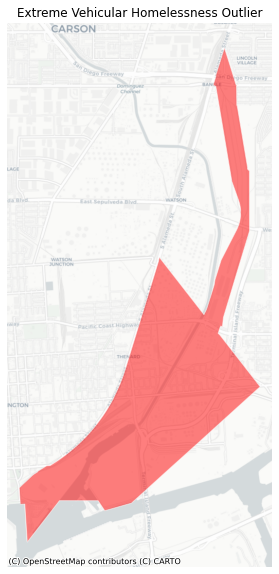

In [23]:
fig,ax = plt.subplots(figsize=(12,10))
merge.sort_values(by='total_per_1000',ascending=False)[:1].plot(ax=ax,
                                                                 color='red',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)

ax.set_title('Extreme Vehicular Homelessness Outlier')
ax.axis('off')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Checking it against Google Maps, this is a heavily industrial area of San Pedro. An unusually high rate of camper-based homelessness is plausible here. Still, I need to talk to a licensed statistician before I'm comfortable removing it.

# Diamonds, Donuts, and Spatial Lag

Okay, that was fun, but let's move along! I'll be analyzing total vehicular homelessness today, but I'm going to go ahead and tee up the data for the three specific types and finish that next week, since I know that they each behave differently, spatially speaking.

First I need to add a KNN weight. I don't fully understand how this works yet, so I'm going to go with '8,' which we used in the lab.

In [24]:
wq =  lps.weights.KNN.from_dataframe(merge,k=8)
wq.transform = 'r'

Next I'm going to figure out the spatial lag, so I can identify the donut -- a tract with low vehicular homelessness surrounded by high vehicular homelessness -- and the diamond -- the inverse.

In [25]:
merge['total_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['total_per_1000'])
merge['cars_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['cars_per_1000'])
merge['vans_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['vans_per_1000'])
merge['campers_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['campers_per_1000'])

Let's check our work.

In [26]:
merge.head(5)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.000000,0.000000,0.000000,0.000000,9.726659,8.046862,0.513670,1.166127
1,101122,1,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-13166582.389 4063754.268, -13...",3405.0,1.560059,0.471953,1.088106,0.000000,9.273658,7.871651,0.243765,1.158241
2,101210,1,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-13167528.828 4063214.447, -13...",6347.0,2.047424,0.253190,1.167481,0.626753,9.247213,7.932480,0.367735,0.946998
3,101220,1,0.000,0.000,15.912,15.912,"MULTIPOLYGON (((-13166665.322 4063197.342, -13...",3702.0,4.298217,0.000000,0.000000,4.298217,8.965864,7.964129,0.513670,0.488065
4,101300,1,0.000,0.000,1.989,1.989,"MULTIPOLYGON (((-13165228.967 4062741.047, -13...",3884.0,0.512101,0.000000,0.000000,0.512101,9.291568,7.932820,0.513670,0.845077


And now, to identify the head and tail:

In [27]:
merge['total_lag_diff'] = merge['total_per_1000'] - merge['total_per_1000_lag']
merge['cars_lag_diff'] = merge['cars_per_1000'] - merge['cars_per_1000_lag']
merge['vans_lag_diff'] = merge['vans_per_1000'] - merge['vans_per_1000_lag']
merge['campers_lag_diff'] = merge['campers_per_1000'] - merge['campers_per_1000_lag']

Let's again first check it.

In [28]:
merge.head(5)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.000000,0.000000,0.000000,0.000000,9.726659,8.046862,0.513670,1.166127,-9.726659,-8.046862,-0.513670,-1.166127
1,101122,1,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-13166582.389 4063754.268, -13...",3405.0,1.560059,0.471953,1.088106,0.000000,9.273658,7.871651,0.243765,1.158241,-7.713599,-7.399698,0.844341,-1.158241
2,101210,1,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-13167528.828 4063214.447, -13...",6347.0,2.047424,0.253190,1.167481,0.626753,9.247213,7.932480,0.367735,0.946998,-7.199789,-7.679290,0.799746,-0.320245
3,101220,1,0.000,0.000,15.912,15.912,"MULTIPOLYGON (((-13166665.322 4063197.342, -13...",3702.0,4.298217,0.000000,0.000000,4.298217,8.965864,7.964129,0.513670,0.488065,-4.667647,-7.964129,-0.513670,3.810153
4,101300,1,0.000,0.000,1.989,1.989,"MULTIPOLYGON (((-13165228.967 4062741.047, -13...",3884.0,0.512101,0.000000,0.000000,0.512101,9.291568,7.932820,0.513670,0.845077,-8.779467,-7.932820,-0.513670,-0.332976


Nice. Let's find the donut for total vehicular homelessness.

In [29]:
merge.sort_values(by='total_lag_diff')
total_donut = merge.sort_values(by='total_lag_diff').head(1)
total_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,1369.139254,206.249682,106.156561,1056.733011,-1368.434791,-206.249682,-106.156561,-1056.028548


This doesn't tell me much. Let's go ahead and map it.

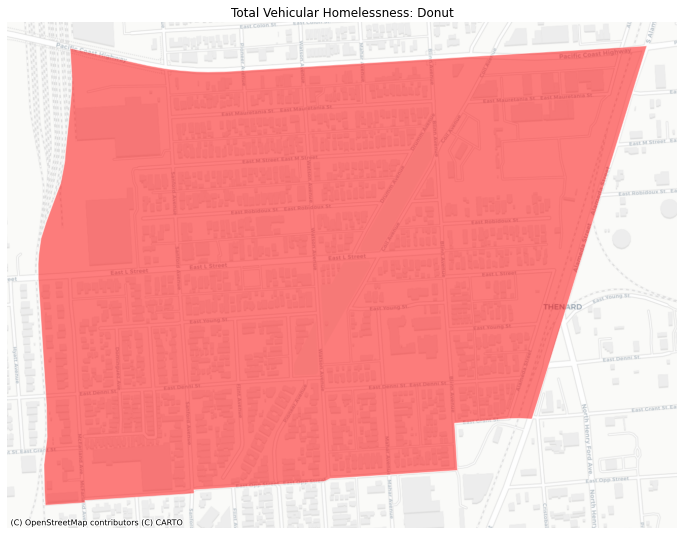

In [30]:
fig,ax = plt.subplots(figsize=(12,10))
total_donut.plot(ax=ax,
                     color='red',
                     edgecolor='white',
                     alpha=0.5,legend=True)

ax.set_title('Total Vehicular Homelessness: Donut')
ax.axis('off')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Okay, that's cool: so it's the residential neighborhood next to that extreme outlier that we identified in San Pedro. Let's go ahead and identify all the donuts and diamond (this metaphor is making me increasingly hungry) and map a few using Plotly Express and its Mapbox Satellite.

It would be cool if a few of these donuts were in OPDs, as it would confirm my suspicion that they are being mapped to exclude vehicular homelessness. (Note for a future version of this notebook: try and function/loop this?)

In [31]:
total_diamond = merge.sort_values(by='total_lag_diff').tail(1)
total_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,5.559204,0.379057,1.307276,3.872871,10912.774129,1647.28761,838.470501,8427.016018


Look familiar? It's our old friend industrial San Pedro.

In [32]:
merge.sort_values(by='cars_lag_diff')
cars_donut = merge.sort_values(by='cars_lag_diff').head(1)
cars_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
962,294701,1,0.0,9.447,19.794,29.241,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",3099.0,9.435624,0.0,3.048403,6.387222,1368.281072,206.274681,105.91223,1056.094162,-1358.845447,-206.274681,-102.863827,-1049.70694


In [33]:
cars_diamond = merge.sort_values(by='cars_lag_diff').tail(1)
cars_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,5.559204,0.379057,1.307276,3.872871,10912.774129,1647.28761,838.470501,8427.016018


There she is again.

In [34]:
merge.sort_values(by='cars_lag_diff')
vans_donut = merge.sort_values(by='vans_lag_diff').head(1)
vans_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,1369.139254,206.249682,106.156561,1056.733011,-1368.434791,-206.249682,-106.156561,-1056.028548


In [35]:
vans_diamond = merge.sort_values(by='vans_lag_diff').tail(1)
vans_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,5.559204,0.379057,1.307276,3.872871,10912.774129,1647.28761,838.470501,8427.016018


Dang, this may end up being the universal diamond. It's certainly going to be the camper diamond.

In [36]:
merge.sort_values(by='campers_lag_diff')
campers_donut = merge.sort_values(by='campers_lag_diff').head(1)
campers_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,1369.139254,206.249682,106.156561,1056.733011,-1368.434791,-206.249682,-106.156561,-1056.028548


In [37]:
campers_diamond = merge.sort_values(by='campers_lag_diff').tail(1)
campers_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,5.559204,0.379057,1.307276,3.872871,10912.774129,1647.28761,838.470501,8427.016018


Ladies and gentlemen, we have a universal vehicular homelessness diamond. Tract 294620	is the donut for every variable except car-based homelessness. I wonder why? 

Let's map those donuts in Plotly Express and its Mapbox Satellite.

In [38]:
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

In [39]:
total_donut = total_donut.to_crs('epsg:4326')
minx, miny, maxx, maxy = total_donut.geometry.total_bounds
center_lat_total_donut = (maxy-miny)/2+miny
center_lon_total_donut = (maxx-minx)/2+minx

cars_donut= cars_donut.to_crs('epsg:4326')
minx, miny, maxx, maxy = cars_donut.geometry.total_bounds
center_lat_cars_donut = (maxy-miny)/2+miny
center_lon_cars_donut = (maxx-minx)/2+minx

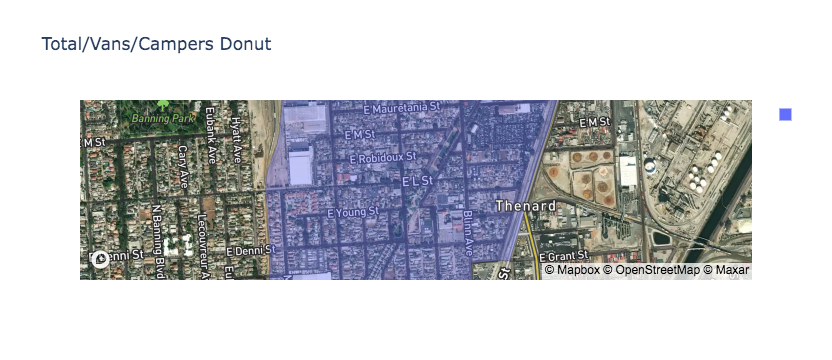

In [40]:
px.choropleth_mapbox(total_donut, 
                     geojson=total_donut.geometry, 
                     locations=total_donut.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_total_donut, "lon": center_lon_total_donut},
                     opacity=0.4,
                     title='Total/Vans/Campers Donut')

Looks good! But we already knew about that one. Let's find that weird car-based vehicular homelessness donut.

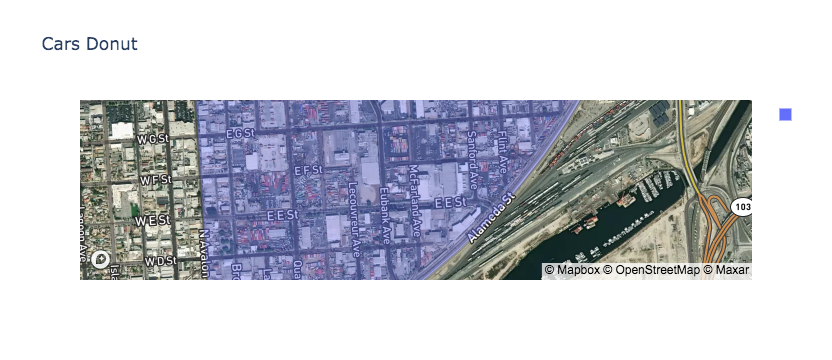

In [41]:
px.choropleth_mapbox(cars_donut, 
                     geojson=cars_donut.geometry, 
                     locations=cars_donut.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_cars_donut, "lon": center_lon_cars_donut},
                     opacity=0.4,
                     title='Cars Donut')

Oh, so that's not terribly exciting. It's just another residential neighborhood in San Pedro!

Let's see how these maps change with a spatial lag added in.

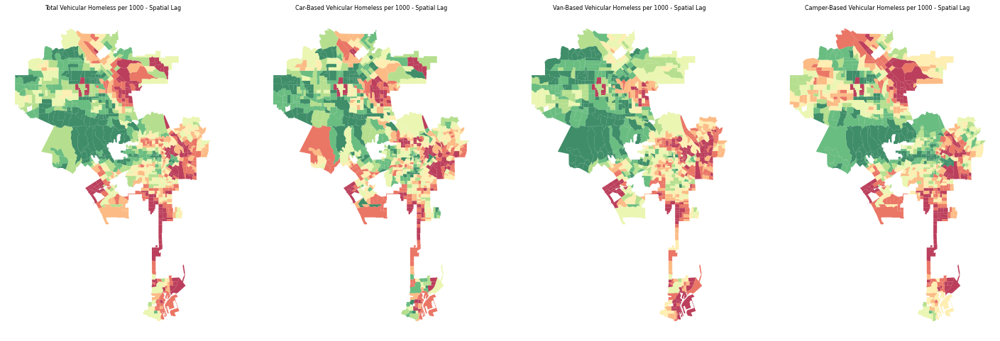

In [42]:
# create the 1x2 subplots
fig, axs = plt.subplots(1, 4, figsize=(25, 25))

ax1, ax2, ax3, ax4 = axs

merge.plot(ax=ax1,
         column='total_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax1.axis("off")
ax1.set_title("Total Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

merge.plot(ax=ax2,
         column='cars_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax2.axis("off")
ax2.set_title("Car-Based Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

merge.plot(ax=ax3,
         column='vans_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax3.axis("off")
ax3.set_title("Van-Based Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

merge.plot(ax=ax4,
         column='campers_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax4.axis("off")
ax4.set_title("Camper-Based Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

plt.show()

Cool, so this mostly affirms what we already knew, but with lightly less chaotic maps. You can see the effect of spatial lag. Let's make an interactive version for total vehicular homelessness.

In [43]:
merge_web = merge.to_crs('EPSG:4326')

In [44]:
minx, miny, maxx, maxy = merge_web.geometry.total_bounds
center_lat_merge_web = (maxy-miny)/2+miny
center_lon_merge_web = (maxx-minx)/2+minx

In [45]:
merge_web.total_per_1000_lag.describe()

count    1001.000000
mean        7.375504
std        74.933066
min         0.000000
25%         1.166021
50%         2.038908
75%         3.515767
max      1369.139254
Name: total_per_1000_lag, dtype: float64

In [46]:
median = merge_web.total_per_1000_lag.median()

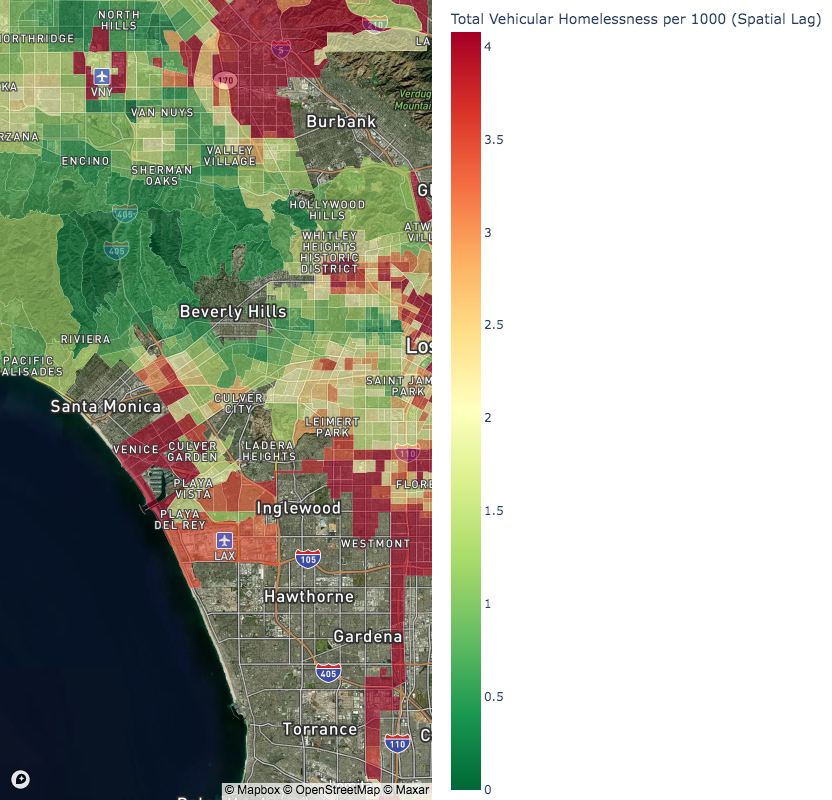

In [47]:
fig = px.choropleth_mapbox(merge_web, 
                     geojson=merge_web.geometry,
                     locations=merge_web.index,
                     mapbox_style="satellite-streets",
                     zoom=10, 
                     color='total_per_1000_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint = median,
                     range_color =(0,median*2),
                     hover_data=['tract','TotalPop','total_per_1000','total_per_1000_lag','cars_per_1000','cars_per_1000_lag','vans_per_1000','vans_per_1000_lag','campers_per_1000_lag','campers_per_1000_lag'],
                     center = {"lat": center_lat_merge_web, "lon": center_lon_merge_web},
                     opacity=0.6,
                     width=1000,
                     height=800,
                     labels={
                             'total_per_1000_lag':'Total Vehicular Homelessness per 1000 (Spatial Lag)',
                             'total_per_1000':'Total Vehicular Homelessness per 1000',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

This makes the data about a million times easier to explore. I can't help but notice how closely this tracks onto general arrest data. Are the vehicular homeless more likely to commit crimes? Or are they simply more likely to be bothered by law enforcement? Or, even worse: are we shuffling the vehicular homeless into high-crime tracts?

## Moran 1

Okay, let's start on this Moran business.  First, the global autocorrelation.

In [48]:
y = merge.total_per_1000
moran = Moran(y, wq)
moran.I

-7.109296143456223e-05

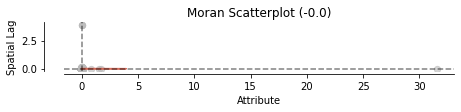

In [49]:
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

Weirdly, the figure is negative, which means that similar values are far from one another; that is to say, tracts with high vehicular homelessness do not colocate. I wonder how the extreme outlier in San Pedro is affecting this? Would it be appropriate to remove it?

(<Figure size 504x504 with 1 Axes>,
 <AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: -0.0', ylabel='Density'>)

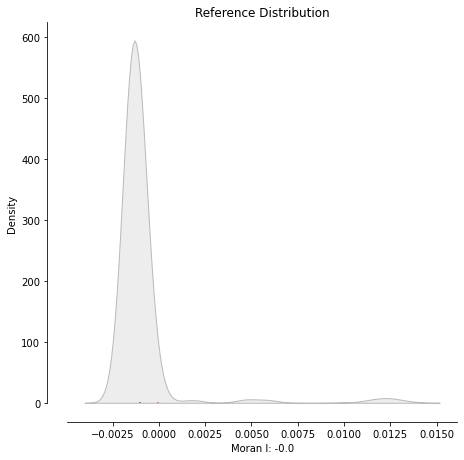

In [50]:
plot_moran_simulation(moran,aspect_equal=False)

In [51]:
moran.p_sim

0.044

So what does this mean? Apparently alike tracts are removed from one another at statistically significant rates at (barely) 95% confidence. Evidently vehicular homelessness isn't nearly as clustered as I assumed it might be. Could the deployment of more OPDs change that?

I'm now going to run the Local Indicators of Spatial Association (LISA) analysis. If LH tracts are within OPDs, it would partially affirm my hypothesis.

In [52]:
lisa = esda.moran.Moran_Local(y, wq)

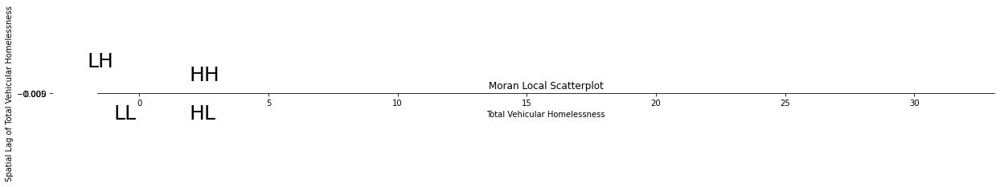

In [53]:
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisa, ax=ax, p=0.05)
ax.set_xlabel("Total Vehicular Homelessness")
ax.set_ylabel('Spatial Lag of Total Vehicular Homelessness')


plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

That doesn't look right! This is almost certainly the result of those outliers. I will need to rerun it after consulting with someone more enmeshed in the stats re: dealing with the outliers...in any case, we can still map it and see what it shows.

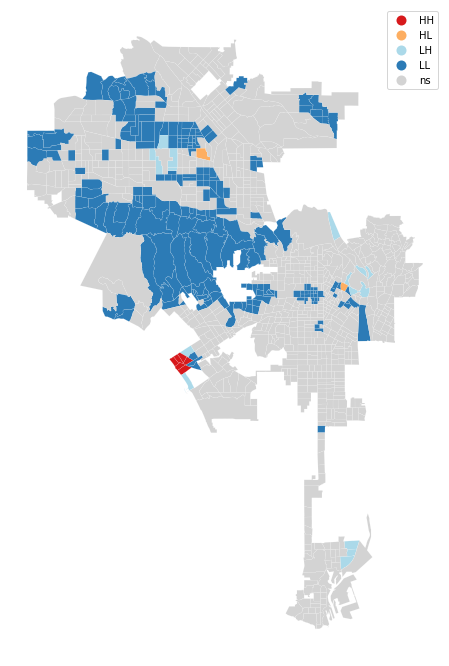

In [54]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, merge, p=0.05, ax=ax)
plt.show()

That looks *kind of* right. Some of this is to be expected: concentrations in Venice, little vehicular homelessness in affluent neighborhoods in the hills, etc. There does seem to be a LH in Venice that benefits from an OPD. But a lot of this isn't expected: Downtown and industrial areas of North Hollywood and South Los Angeles somehow don't show up as HHs?

Let's check it at three levels of significance.

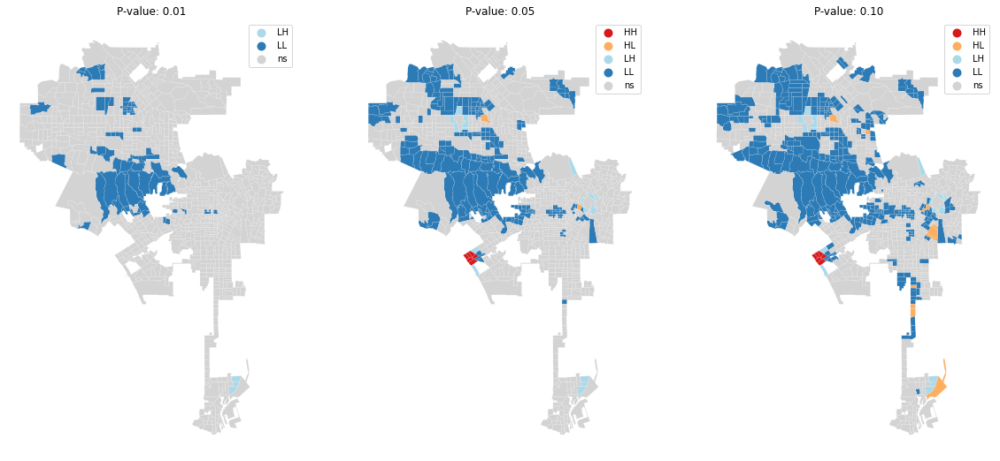

In [55]:
fig, axs = plt.subplots(1, 3, figsize=(20, 12))
ax1, ax2, ax3 = axs

lisa_cluster(lisa, merge, p=0.01, ax=ax1)
ax1.axis("off")
ax1.set_title("P-value: 0.01")

lisa_cluster(lisa, merge, p=0.05, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.05")

lisa_cluster(lisa, merge, p=0.10, ax=ax3)
ax3.axis("off")
ax3.set_title("P-value: 0.10")


plt.show()

So there you have it: the significant autocorrelation is overwhelmingly among LL tracts. Exceptions to this are HH tracts in Venice and HL tracts around Downtown. 

## Conclusion

Alright, so that was a little weird. I have two big tasks for next week:
1. Figure out whether I should remove the outlier(s) and how this might affect the output.
2. Run the Moran I analysis for the three types of vehicular homelessness (cars, vans, and campers) to see how they vary.

Once I'm confident that I've identified the statistically significant clusters of vehicular homelessness, I can then see how these interact with the geography of OPDs.

*Nolan did everything, which is why it's not very good!*